In [11]:
import sys
sys.path.append("../Decision Tree")
from TreeNode import TreeNode
from DecisionTree import ID3
from utils import predict, calculate_error_rate, preprocess_numerical_columns


In [ ]:

import math

In [24]:
# Get Decision Stump
def weighted_decision_stump(S, Attributes, weights, purity_measurement=None):
    # 如果没有设置纯度度量标准，则使用默认值
    if not purity_measurement:
        purity_measurement = 'entropy'

    # 使用ID3的逻辑选择最佳属性，但现在考虑权重
    best_attribute = find_best_attribute(S, Attributes, weights, purity_measurement)

    # 使用该属性创建决策桩
    stump = TreeNode(attribute=best_attribute)

    # 对于属性的每个可能值，为决策桩添加一个叶节点
    for value in S[best_attribute].unique():
        subset = S[S[best_attribute] == value]
        # 使用权重的加权大多数来决定叶节点的类标签
        if not subset.empty:
            weighted_majority_label = find_weighted_majority_label(subset, weights)
            stump.add_child(value, TreeNode(label=weighted_majority_label))
        else:
            # 如果子集为空，则选择整体的加权多数标签
            weighted_majority_label = find_weighted_majority_label(S, weights)
            stump.add_child(value, TreeNode(label=weighted_majority_label))

    return stump


def calculate_weighted_error(y_true, y_pred, sample_weights):
    """
    y_true: true label
    y_pred: pred label
    sample_weights: weight of the sample
    """
    misclassified_weights = [weight for true_label, pred_label, weight in zip(y_true, y_pred, sample_weights) if true_label != pred_label]
    weighted_error = sum(misclassified_weights) / sum(sample_weights)
    return weighted_error


def calculate_classifier_weight(error_rate):
    """
    error_rate: the weak classifier weight alpha
    """
    if error_rate == 0:
        return float('inf') 
    elif error_rate == 1:
        return 0
    else:
        return 0.5 * math.log((1 - error_rate) / error_rate)
    

def adaboost(X, y, num_iterations):
    """
    X: training data
    y: true label
    num_iterations: num of iteration in AdaBoost
    """
    
    num_samples = len(X)
    
    # weight initialization
    sample_weights = [1.0 / num_samples] * num_samples
    weak_classifiers = []
    classifier_weights = []

    for _ in range(num_iterations):
        # training weak classifier
        stump = decision_stump(X, y, sample_weights)
        
        # 获取决策桩的预测
        y_pred = [stump.predict(x) for x in X] 
        
        # 计算加权误差
        error = calculate_weighted_error(y, y_pred, sample_weights)
        
        # 计算分类器权重
        alpha = calculate_classifier_weight(error)
        
        # 更新数据权重
        for i in range(num_samples):
            if y[i] != y_pred[i]:
                sample_weights[i] *= math.exp(alpha)
            else:
                sample_weights[i] *= math.exp(-alpha)
        
        # 归一化数据权重
        weight_sum = sum(sample_weights)
        sample_weights = [w / weight_sum for w in sample_weights]

        # 存储分类器及其权重
        weak_classifiers.append(stump)
        classifier_weights.append(alpha)
    
    # 返回训练好的分类器
    return weak_classifiers, classifier_weights

# 3. 组合所有决策桩以形成最终的强分类器
def predict_strong_classifier(x, weak_classifiers, classifier_weights):
    predictions = [alpha * stump.predict(x) for alpha, stump in zip(classifier_weights, weak_classifiers)]
    return 1 if sum(predictions) >= 0 else -1


In [59]:
# Get Decision Stump
def weighted_entropy(data, weights, class_list):
    total = sum(weights)
    entropy = 0
    for label in class_list:
        weight_for_label = sum(w for w, d in zip(weights, data.iloc[:, -1]) if d == label)
        p = weight_for_label / total
        if p > 0:
            entropy -= p * math.log2(p)
    return entropy

def calculate_info_gain(feature_name, data, weights, class_list):
    total_row = data.shape[0]
    feature_info = 0.0
    total_entropy = weighted_entropy(data, weights, class_list)

    for feature_value in data[feature_name].unique():
        feature_value_data = data[data[feature_name] == feature_value]  # filtering rows with that feature_value
        feature_value_weights = [w for w, d in zip(weights, data[feature_name]) if d == feature_value]
        feature_value_probability = sum(feature_value_weights) / sum(weights)
        
        feature_value_entropy = weighted_entropy(feature_value_data, feature_value_weights, class_list)
        feature_info += feature_value_probability * feature_value_entropy

    return total_entropy - feature_info


def find_best_attribute(data, attributes, weights, class_list):
    max_info_gain = -1
    max_info_feature = None

    for attribute in attributes:  #for each feature in the dataset
        feature_info_gain = calculate_info_gain(attribute, data, weights, class_list)
        if max_info_gain < feature_info_gain: #selecting feature name with highest information gain
            max_info_gain = feature_info_gain
            max_info_feature = attribute
        # print(f"Attribute: {attribute}, Info Gain: {feature_info_gain}, Weights: {weights}")
            
    return max_info_feature

def weighted_decision_stump(data, attributes, weights):
    # 获取数据集中的唯一标签值
    class_list = data.iloc[:, -1].unique().tolist()

    # 根据加权信息增益查找最佳属性
    best_attribute = find_best_attribute(data, attributes, weights, class_list)

    # 创建根节点
    root = TreeNode(attributes=best_attribute)

    # 对于最佳属性的每个唯一值
    # print(f"Selected Best Attribute: {best_attribute}")
    for value in data[best_attribute].unique():
        subset = data[data[best_attribute] == value]
        most_common_label = subset.iloc[:, -1].value_counts().idxmax()
        # print(f"Value: {value}, Most Common Label: {most_common_label}")
        
        child_node = TreeNode(label=most_common_label, attributes=value)  # value作为子节点的属性，用于知道该节点对应哪个属性值
        root.add_child(child_node)

    return root


In [60]:
data = pd.DataFrame({'Class': ['Yes', 'No', 'Yes', 'No']})
weights = [0.5, 0.2, 0.2, 0.1]
class_list = ['Yes', 'No']
result = weighted_entropy(data, weights, class_list)
print(result)

0.8812908992306926


In [61]:
import pandas as pd
import math

In [74]:
# 创建一个简单的数据集
data_dict = {
    'Weather': ['Sunny', 'Overcast', 'Rainy', 'Sunny', 'Sunny', 'Overcast', 'Rainy', 'Rainy'],
    'Wind': ['Weak', 'Strong', 'Weak', 'Weak', 'Strong', 'Strong', 'Weak', 'Strong'],
    'PlayTennis': ['No', 'Yes', 'Yes', 'Yes', 'No', 'Yes', 'No', 'Yes']
}

data = pd.DataFrame(data_dict)

# 为每个样本定义权重
weights = [0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125]

attributes = ['Weather', 'Wind']

# 使用函数创建决策桩
stump = weighted_decision_stump(data, attributes, weights)

# 打印决策桩
print(stump)


Attribute: Weather, Label: None
Child:
  Attribute: Sunny, Label: No
Child:
  Attribute: Overcast, Label: Yes
Child:
  Attribute: Rainy, Label: Yes



In [76]:
# 为每个样本定义权重
weights = [0.1, 0.1, 0.3, 0.1, 0.1, 0.1, 0.1, 0.1]

attributes = ['Weather', 'Wind']

# 使用函数创建决策桩
stump = weighted_decision_stump(data, attributes, weights)
print(stump)

Attribute: Weather, Label: None
Child:
  Attribute: Sunny, Label: No
Child:
  Attribute: Overcast, Label: Yes
Child:
  Attribute: Rainy, Label: Yes



In [12]:
predictions = predict(stump, data)
true_labels = data.iloc[:, -1].tolist()
error_rate = calculate_error_rate(predictions, true_labels)
print(f"Training Error Rate {error_rate:.3f}")

Training Error Rate 0.250


In [ ]:
data_dict = {
    'Weather': ['Sunny', 'Overcast', 'Rainy', 'Sunny', 'Sunny', 'Overcast', 'Rainy', 'Rainy'],
    'Wind': ['Weak', 'Strong', 'Weak', 'Weak', 'Strong', 'Strong', 'Weak', 'Strong'],
    'PlayTennis': ['No', 'Yes', 'Yes', 'Yes', 'No', 'Yes', 'No', 'Yes']
}


In [63]:
import numpy as np

def adaboost(data, attributes, T):
    """
    data: DataFrame containing the training data
    attributes: List of column names of the features
    T: Number of iterations or weak classifiers to train
    """
    
    N = len(data)  # Number of data points
    weights = [1/N] * N  # Initialize weights
    weak_classifiers = []  # List to store the trained weak classifiers (decision stumps)
    alphas = []  # List to store the alpha values for each classifier
    
    for t in range(T):
        # Train a decision stump using the weighted data
        # print("weights before tree grow: ", weights)
        stump = weighted_decision_stump(data, attributes, weights)
        weak_classifiers.append(stump)
        
        # Make predictions using the stump on all data points
        predictions = predict(stump, data)  # assuming you have a 'predict' function
        actual = data.iloc[:, -1].tolist()
        # print("predictions: ", predictions)
        # print("actual: ", actual)
        
        # Calculate the weighted error
        weighted_error = sum([weights[i] for i in range(N) if predictions[i] != actual[i]])
        print(f"Iteration {t + 1} weighted_error: {weighted_error}")
        # Calculate the alpha value for this classifier
        alpha = 0.5 * np.log((1 - weighted_error) / max(weighted_error, 1e-10))
        alphas.append(alpha)
        print(f"Iteration {t + 1} alphas: {alphas}")
        # Update the weights for the next iteration
        for i in range(N):
            if predictions[i] == actual[i]:
                weights[i] = weights[i] * np.exp(-alpha)
                # print("true label for {} and weights {}".format(i, weights[i]))
            else:
                weights[i] = weights[i] * np.exp(alpha)
                # print("false label for {} and weights {}".format(i, weights[i]))

        # print("weights before normalization: ", weights)
        
        # Normalize the weights to sum up to 1
        total_weight = sum(weights)
        # print("total_weight",total_weight)
        weights = [w/total_weight for w in weights]

        # print("sum weights",sum(weights))
        # print(f"Iteration {t + 1} weights: {weights}")

    
    return weak_classifiers, alphas

# def predict(node, data_point):
#     """
#     node: The root of the decision stump (TreeNode object)
#     data_point: A single row from the DataFrame to predict on
#     """
    
#     # If the current node has a label, return it
#     if node.label is not None:
#         return node.label
    
#     # Otherwise, move to the appropriate child based on the data_point's attribute value
#     for child in node.children:
#         if child.attributes == data_point[node.attributes]:
#             return predict(child, data_point)
    
#     # If no matching child is found (this shouldn't usually happen), you can either return a default label 
#     # or handle this case differently based on the specific requirements of your application.
#     return 'Unknown'

def predict(tree, df_test):
    """
    tree: The tree that has been build from ID3
    df_test: test dataset, dataframe
    return: a list of all prediction labels
    """
    predictions = []
    for index, row in df_test.iterrows():
        node = tree
        while node.children: 
            attribute_name = node.attributes 
            attribute_value = row[attribute_name] 
            matched_child = None
            for child in node.children:
                if child.attributes == attribute_value:  
                    matched_child = child  
                    break
            if matched_child:
                node = matched_child
                for subnode in node.children:
                    node = subnode
            else:
                break
        predictions.append(node.label)  

    return predictions

In [64]:
# Sample training data
train_data = pd.DataFrame({
    'Weather': ['Sunny', 'Overcast', 'Rainy', 'Sunny', 'Sunny', 'Overcast', 'Rainy', 'Rainy', 'Sunny', 'Sunny'],
    'Wind': ['Weak', 'Strong', 'Weak', 'Weak', 'Strong', 'Strong', 'Weak', 'Strong', 'Strong', 'Weak'],
    'Play': ['No', 'Yes', 'Yes', 'No', 'Yes', 'Yes', 'No', 'Yes', 'No', 'No']
})

# Sample test data
test_data = pd.DataFrame({
    'Weather': ['Sunny', 'Overcast', 'Rainy', 'Sunny'],
    'Wind': ['Weak', 'Strong', 'Weak', 'Weak'],
    'Play': ['No', 'Yes', 'Yes', 'Yes']  # This is just a sample, and might not represent the actual relationship.
})

attributes = ['Weather', 'Wind']


T = 5
weak_classifiers, alphas = adaboost(train_data, attributes, T)


# def adaboost_predict(data_point, weak_classifiers, alphas):
#     predictions = [predict(classifier, data_point) for classifier in weak_classifiers]
#     weighted_predictions = [alphas[i] * (1 if predictions[i] == 'Yes' else -1) for i in range(len(alphas))]
#     return 'Yes' if sum(weighted_predictions) >= 0 else 'No'

# for index, row in test_data.iterrows():
#     data_point = row.drop('Play')
#     true_label = row['Play']
#     prediction = adaboost_predict(data_point, weak_classifiers, alphas)
#     print(f"Data Point: {data_point['Weather']}, True Label: {true_label}, Prediction: {prediction}")




Iteration 1 weighted_error: 0.2
Iteration 1 alphas: [0.6931471805599453]
Iteration 2 weighted_error: 0.12499999999999999
Iteration 2 alphas: [0.6931471805599453, 0.9729550745276567]
Iteration 3 weighted_error: 0.28571428571428575
Iteration 3 alphas: [0.6931471805599453, 0.9729550745276567, 0.45814536593707733]
Iteration 4 weighted_error: 0.3500000000000001
Iteration 4 alphas: [0.6931471805599453, 0.9729550745276567, 0.45814536593707733, 0.3095196042031115]
Iteration 5 weighted_error: 0.38461538461538464
Iteration 5 alphas: [0.6931471805599453, 0.9729550745276567, 0.45814536593707733, 0.3095196042031115, 0.23500181462286782]


In [68]:
import pandas as pd
def adaboost_predict(test_data: pd.DataFrame, weak_classifiers, alphas):
    n = len(test_data)
    final_predictions = []
    aggregate_predictions = [0] * n
    
    for i in range(len(weak_classifiers)):
        weak_predictions = predict(weak_classifiers[i], test_data)
        for j in range(n):
            # 这里假设'Yes'对应+1，'No'对应-1
            aggregate_predictions[j] += alphas[i] * (1 if weak_predictions[j] == 'yes' else -1)
    
    for score in aggregate_predictions:
        if score >= 0:
            final_predictions.append('yes')
        else:
            final_predictions.append('no')
    
    return final_predictions


In [54]:
test_data.head()

,Weather,Wind,Play
0,Sunny,Weak,No
1,Overcast,Strong,Yes
2,Rainy,Weak,Yes
3,Sunny,Weak,Yes


In [55]:
test_predictions = adaboost_predict(test_data, weak_classifiers, alphas)
print(test_predictions)

['No', 'Yes', 'Yes', 'No']


In [56]:
true_labels = test_data.iloc[:, -1].tolist()
error_rate = calculate_error_rate(test_predictions, true_labels)
print(error_rate)

0.25


In [72]:
T = 1
attributes = train_data.columns.tolist()[:-1]
weak_classifiers, alphas = adaboost(train_data, attributes, T)
test_predictions = adaboost_predict(test_data, weak_classifiers, alphas)
true_labels = test_data.iloc[:, -1].tolist()
error_rate = calculate_error_rate(test_predictions, true_labels)
print(error_rate)

Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
0.1248


In [73]:
T = 3
attributes = train_data.columns.tolist()[:-1]
weak_classifiers, alphas = adaboost(train_data, attributes, T)
test_predictions = adaboost_predict(test_data, weak_classifiers, alphas)
true_labels = test_data.iloc[:, -1].tolist()
error_rate = calculate_error_rate(test_predictions, true_labels)
print(error_rate)

Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
Iteration 2 weighted_error: 0.5000000000000077
Iteration 2 alphas: [1.0000139153886038, -1.5321077739827394e-14]
Iteration 3 weighted_error: 0.5000000000000091
Iteration 3 alphas: [1.0000139153886038, -1.5321077739827394e-14, -1.82076576038529e-14]
0.1248


In [71]:
def calculate_error_rate(predictions, true_labels):
    assert len(predictions) == len(true_labels), "Length mismatch between predictions and true labels."
    incorrect_predictions = sum(1 for pred, true in zip(predictions, true_labels) if pred != true)
    return incorrect_predictions / len(predictions)


for T in range(1, 11): # 从1到10
    # 使用Adaboost来训练弱分类器
    weak_classifiers, alphas = adaboost(train_data, attributes, T)

    # 对于训练数据，计算预测并计算误差率
    train_predictions = adaboost_predict(train_data, weak_classifiers, alphas)
    train_true_labels = train_data.iloc[:, -1].tolist()
    train_error_rate = calculate_error_rate(train_predictions, train_true_labels)

    # 对于测试数据，计算预测并计算误差率
    test_predictions = adaboost_predict(test_data, weak_classifiers, alphas)
    test_true_labels = test_data.iloc[:, -1].tolist()
    test_error_rate = calculate_error_rate(test_predictions, test_true_labels)

    print(f"For T={T}, Training Error Rate: {train_error_rate:.4f}, Test Error Rate: {test_error_rate:.4f}")


Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
For T=1, Training Error Rate: 0.1192, Test Error Rate: 0.1248
Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
Iteration 2 weighted_error: 0.5000000000000077
Iteration 2 alphas: [1.0000139153886038, -1.5321077739827394e-14]
For T=2, Training Error Rate: 0.1192, Test Error Rate: 0.1248
Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
Iteration 2 weighted_error: 0.5000000000000077
Iteration 2 alphas: [1.0000139153886038, -1.5321077739827394e-14]
Iteration 3 weighted_error: 0.5000000000000091
Iteration 3 alphas: [1.0000139153886038, -1.5321077739827394e-14, -1.82076576038529e-14]
For T=3, Training Error Rate: 0.1192, Test Error Rate: 0.1248
Iteration 1 weighted_error: 0.11920000000000136
Iteration 1 alphas: [1.0000139153886038]
Iteration 2 weighted_error: 0.5000000000000077
Iteration 2 alphas: [1.0000139153886038, -1.53210

In [67]:
# test
def preprocess_data(df):
    # Convert continuous attributes to binary
    for column in ['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']:
        median = df[column].median()
        df[column] = df[column].apply(lambda x: 1 if x > median else 0)
    
    # Note: For columns with "unknown", we'll leave them as is. Pandas will treat them as a separate category.
    
    return df

# Load the training and test data
test_file_path = "Data/bank-4/test.csv"
train_file_path = "Data/bank-4/train.csv"
column_names = ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous', 'poutcome', 'y']
df_bank_train = pd.read_csv(train_file_path, names=column_names)
df_bank_test = pd.read_csv(test_file_path, names=column_names)


# Apply preprocessing to train and test datasets
train_data = preprocess_data(df_bank_train)
test_data = preprocess_data(df_bank_test)

# Preview the preprocessed train data
print(train_data.head())


   age          job  marital  education default  balance housing loan  \
0    1     services  married  secondary      no        0     yes   no   
1    1  blue-collar   single  secondary      no        0     yes  yes   
2    1   technician  married  secondary      no        1      no  yes   
3    1       admin.  married   tertiary      no        0     yes   no   
4    0   management   single   tertiary      no        1      no   no   

    contact  day month  duration  campaign  pdays  previous poutcome    y  
0   unknown    0   may         0         0      0         0  unknown   no  
1  cellular    0   feb         1         0      0         0  unknown   no  
2  cellular    1   aug         1         0      1         1  success  yes  
3  cellular    0   jul         1         0      0         0  unknown   no  
4  cellular    0   apr         0         0      0         0  unknown  yes  


In [155]:
import pandas as pd

# Create a dictionary with the sample data
data_dict = {
    'age': [1, 1, 1],
    'job': ['technician', 'services', 'technician'],
    'marital': ['married', 'single', 'married'],
    'education': ['secondary', 'secondary', 'secondary'],
    'default': ['no', 'no', 'no'],
    'balance': [0, 1, 1],
    'housing': ['yes', 'no', 'no'],
    'loan': ['no', 'yes', 'yes'],
    'contact': ['unknown', 'cellular', 'cellular'],
    'day': [0, 0, 0],
    'month': ['may', 'feb', 'feb'],
    'duration': [0, 1, 1],
    'campaign': [0, 0, 0],
    'pdays': [0, 1, 1],
    'previous': [0, 1, 1],
    'poutcome': ['success', 'unknown', 'success'],
    'y': ['no', 'no', 'yes']
}

# Convert the dictionary to a DataFrame
sample_train_data = pd.DataFrame(data_dict)

print(sample_train_data)


   age         job  marital  education default  balance housing loan   
0    1  technician  married  secondary      no        0     yes   no  \
1    1    services   single  secondary      no        1      no  yes   
2    1  technician  married  secondary      no        1      no  yes   

    contact  day month  duration  campaign  pdays  previous poutcome    y  
0   unknown    0   may         0         0      0         0  success   no  
1  cellular    0   feb         1         0      1         1  unknown   no  
2  cellular    0   feb         1         0      1         1  success  yes  


In [156]:
import pandas as pd

# Create a dictionary with the test data
test_data_dict = {
    'age': [1, 0, 1],
    'job': ['management', 'blue-collar', 'retired'],
    'marital': ['single', 'married', 'married'],
    'education': ['secondary', 'secondary', 'primary'],
    'default': ['no', 'no', 'no'],
    'balance': [1, 1, 1],
    'housing': ['no', 'no', 'no'],
    'loan': ['no', 'no', 'no'],
    'contact': ['cellular', 'cellular', 'telephone'],
    'day': [0, 0, 1],
    'month': ['jun', 'may', 'jul'],
    'duration': [1, 1, 0],
    'campaign': [0, 0, 1],
    'pdays': [0, 1, 0],
    'previous': [0, 1, 0],
    'poutcome': ['unknown', 'failure', 'unknown'],
    'y': ['yes', 'no', 'yes']
}

# Convert the dictionary to a DataFrame
sample_test_data = pd.DataFrame(test_data_dict)

print(sample_test_data)


   age          job  marital  education default  balance housing loan   
0    1   management   single  secondary      no        1      no   no  \
1    0  blue-collar  married  secondary      no        1      no   no   
2    1      retired  married    primary      no        1      no   no   

     contact  day month  duration  campaign  pdays  previous poutcome    y  
0   cellular    0   jun         1         0      0         0  unknown  yes  
1   cellular    0   may         1         0      1         1  failure   no  
2  telephone    1   jul         0         1      0         0  unknown  yes  


In [157]:
attributes = sample_train_data.columns[:-1]

T = 2
weak_classifiers, alphas = adaboost(sample_train_data, attributes, T)

for index, row in sample_test_data.iterrows():
    data_point = row.drop('y')
    true_label = row['y']
    prediction = adaboost_predict(data_point, weak_classifiers, alphas)
    print(f"Data Point: {data_point.to_dict()}, True Label: {true_label}, Prediction: {prediction}")

Attribute: age, Info Gain: 0.0, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: job, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: marital, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: education, Info Gain: 0.0, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: default, Info Gain: 0.0, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: balance, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: housing, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: loan, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.3333333333333333, 0.3333333333333333]
Attribute: contact, Info Gain: 0.2516291673878229, Weights: [0.3333333333333333, 0.333

In [158]:
attributes = train_data.columns[:-1]

T = 2
weak_classifiers, alphas = adaboost(train_data, attributes, T)

for index, row in test_data.iterrows():
    data_point = row.drop('y')
    true_label = row['y']
    prediction = adaboost_predict(data_point, weak_classifiers, alphas)
    print(f"Data Point: {data_point.to_dict()}, True Label: {true_label}, Prediction: {prediction}")

Attribute: age, Info Gain: 0.0007604567497077053, Weights: [0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.00

In [160]:
def compute_error(data, weak_classifiers, alphas):
    """
    Compute error for given data.
    """
    errors = 0
    for index, row in data.iterrows():
        data_point = row.drop('y')
        true_label = row['y']
        prediction = adaboost_predict(data_point, weak_classifiers, alphas)
        if prediction != true_label:
            errors += 1
    return errors / len(data)


attributes = train_data.columns[:-1]

max_T = 50
for T in range(1, max_T + 1):
    weak_classifiers, alphas = adaboost(train_data, attributes, T)

    train_error = compute_error(train_data, weak_classifiers, alphas)
    test_error = compute_error(test_data, weak_classifiers, alphas)

    print(f"Iteration T = {T}, Training Error: {train_error}, Testing Error: {test_error}")


Attribute: age, Info Gain: 0.0007604567497077053, Weights: [0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.0002, 0.00

predictions:  ['no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', 'no', '

KeyboardInterrupt: 

In [115]:
def adaboost_predict(data_point, weak_classifiers, alphas):
    predictions = [predict(classifier, data_point) for classifier in weak_classifiers]
    weighted_predictions = [alphas[i] * (1 if predictions[i] == 'yes' else -1) for i in range(len(alphas))]
    return 'yes' if sum(weighted_predictions) >= 0 else 'no'

def evaluate_adaboost(sample_train_data, sample_test_data, weak_classifiers, alphas):
    def get_error_rate(data):
        total_errors = 0
        for _, row in data.iterrows():
            data_point = row.drop('y')
            true_label = row['y']
            prediction = adaboost_predict(data_point, weak_classifiers, alphas)
            if prediction != true_label:
                total_errors += 1
        return total_errors / len(data)
    
    train_error = get_error_rate(train_data)
    test_error = get_error_rate(test_data)
    
    return train_error, test_error



train_error, test_error = evaluate_adaboost(sample_train_data, sample_test_data, weak_classifiers, alphas)
print(f"Training Error Rate: {train_error * 100:.2f}%")
print(f"Test Error Rate: {test_error * 100:.2f}%")


Training Error Rate: 25.02%
Test Error Rate: 24.68%


In [117]:
# train errors
attributes = train_data.columns[:-1]

T = 10
weak_classifiers, alphas = adaboost(train_data, attributes, T)

train_error, test_error = evaluate_adaboost(train_data, test_data, weak_classifiers, alphas)
print(f"Training Error Rate: {train_error * 100:.2f}%")
print(f"Test Error Rate: {test_error * 100:.2f}%")

Training Error Rate: 11.92%
Test Error Rate: 12.48%


In [119]:
T = 2
weak_classifiers, alphas = adaboost(train_data, attributes, T)

train_error, test_error = evaluate_adaboost(train_data, test_data, weak_classifiers, alphas)
print(f"Training Error Rate: {train_error * 100:.2f}%")
print(f"Test Error Rate: {test_error * 100:.2f}%")

Training Error Rate: 11.92%
Test Error Rate: 12.48%


In [69]:
from sklearn.model_selection import train_test_split

# Split the data into training and test sets
train_data, test_data = train_test_split(data, test_size=0.5)

def error_rate(predictions, actual):
    """Calculate error rate given predictions and actual labels."""
    return sum(predictions != actual) / len(predictions)

def get_adaboost_errors_for_T(T, train_data, test_data, attributes):
    """Train AdaBoost for given T and return training and test errors."""
    weak_classifiers, alphas = adaboost(train_data, attributes, T)
    
    train_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for _, row in train_data.iterrows()]
    test_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for _, row in test_data.iterrows()]
    
    train_error = error_rate(train_predictions, train_data['y'].tolist())
    test_error = error_rate(test_predictions, test_data['y'].tolist())
    
    return train_error, test_error


In [61]:
import pandas as pd

# Load the training and test data
train_data = pd.read_csv('Data/bank-4/train.csv')
test_data = pd.read_csv('Data/bank-4/test.csv')

# Preview the train data
print(train_data.head())

   41     services   married  secondary  no     0  yes no.1   unknown   5   
0  48  blue-collar    single  secondary  no   312  yes  yes  cellular   3  \
1  55   technician   married  secondary  no  1938   no  yes  cellular  18   
2  54       admin.   married   tertiary  no    59  yes   no  cellular  10   
3  34   management    single   tertiary  no  2646   no   no  cellular  14   
4  49       admin.  divorced  secondary  no  1709  yes   no   unknown  12   

   may  114  2   -1  0.1 unknown.1 no.2  
0  feb  369  2   -1    0   unknown   no  
1  aug  193  1  386    3   success  yes  
2  jul  268  1   -1    0   unknown   no  
3  apr  142  1   -1    0   unknown  yes  
4  jun  106  1   -1    0   unknown   no  


In [62]:
print(train_data.columns)

Index(['41', 'services', 'married', 'secondary', 'no', '0', 'yes', 'no.1',
       'unknown', '5', 'may', '114', '2', '-1', '0.1', 'unknown.1', 'no.2'],
      dtype='object')


In [102]:
# Load the training and test data
test_file_path = "Data/bank-4/test.csv"
train_file_path = "Data/bank-4/train.csv"
column_names = ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous', 'poutcome', 'y']
df_bank_train = pd.read_csv(train_file_path, names=column_names)
df_bank_test = pd.read_csv(test_file_path, names=column_names)


In [103]:
def preprocess_data(df):
    # Convert continuous attributes to binary
    for column in ['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']:
        median = df[column].median()
        df[column] = df[column].apply(lambda x: 1 if x > median else 0)
    
    # Note: For columns with "unknown", we'll leave them as is. Pandas will treat them as a separate category.
    
    return df

# Load the training and test data
test_file_path = "Data/bank-4/test.csv"
train_file_path = "Data/bank-4/train.csv"
column_names = ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous', 'poutcome', 'y']
df_bank_train = pd.read_csv(train_file_path, names=column_names)
df_bank_test = pd.read_csv(test_file_path, names=column_names)


# Apply preprocessing to train and test datasets
train_data = preprocess_data(df_bank_train)
test_data = preprocess_data(df_bank_test)

# Preview the preprocessed train data
print(train_data.head())


   age          job  marital  education default  balance housing loan   
0    1     services  married  secondary      no        0     yes   no  \
1    1  blue-collar   single  secondary      no        0     yes  yes   
2    1   technician  married  secondary      no        1      no  yes   
3    1       admin.  married   tertiary      no        0     yes   no   
4    0   management   single   tertiary      no        1      no   no   

    contact  day month  duration  campaign  pdays  previous poutcome    y  
0   unknown    0   may         0         0      0         0  unknown   no  
1  cellular    0   feb         1         0      0         0  unknown   no  
2  cellular    1   aug         1         0      1         1  success  yes  
3  cellular    0   jul         1         0      0         0  unknown   no  
4  cellular    0   apr         0         0      0         0  unknown  yes  


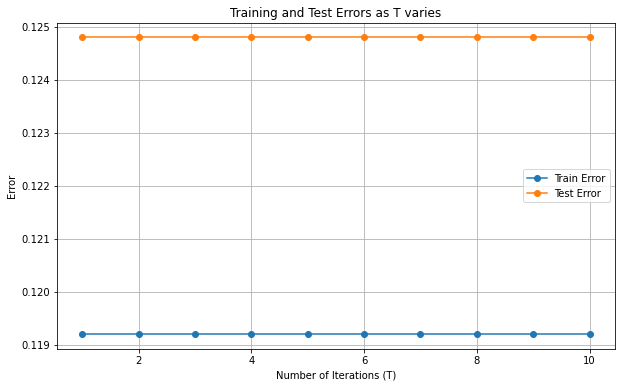

In [79]:
import matplotlib.pyplot as plt

train_errors = []
test_errors = []
T_values = list(range(1, 11))

attributes = list(train_data.columns)[:-1]  

for T in T_values:
    weak_classifiers, alphas = adaboost(train_data, attributes, T)

    train_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in train_data.iterrows()]
    mismatches_train = sum([pred != actual for pred, actual in zip(train_predictions, train_data["y"].tolist())])
    train_error = mismatches_train / len(train_data)
    train_errors.append(train_error)

    test_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in test_data.iterrows()]
    mismatches_test = sum([pred != actual for pred, actual in zip(test_predictions, test_data["y"].tolist())])
    test_error = mismatches_test / len(test_data)
    test_errors.append(test_error)

plt.figure(figsize=(10,6))
plt.plot(T_values, train_errors, label="Train Error", marker='o')
plt.plot(T_values, test_errors, label="Test Error", marker='o')
plt.xlabel("Number of Iterations (T)")
plt.ylabel("Error")
plt.title("Training and Test Errors as T varies")
plt.legend()
plt.grid(True)
plt.show()

In [76]:
attributes = ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous', 'poutcome']

T = 10
weak_classifiers, alphas = adaboost(train_data, attributes, T)


def adaboost_predict(data_point, weak_classifiers, alphas):
    predictions = [predict(classifier, data_point) for classifier in weak_classifiers]
    weighted_predictions = [alphas[i] * (1 if predictions[i] == 'yes' else -1) for i in range(len(alphas))]
    return 'yes' if sum(weighted_predictions) >= 0 else 'no'

In [78]:
T = 10
weak_classifiers, alphas = adaboost(train_data, ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous'], T)

# 计算训练错误
train_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in train_data.iterrows()]
mismatches_train = sum([pred != actual for pred, actual in zip(train_predictions, train_data["y"].tolist())])
train_error = mismatches_train / len(train_data)

# 计算测试错误
test_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in test_data.iterrows()]
mismatches_test = sum([pred != actual for pred, actual in zip(test_predictions, test_data["y"].tolist())])
test_error = mismatches_test / len(test_data)

print(f"Training Error for T = {T}: {train_error:.3f}")
print(f"Test Error for T = {T}: {test_error:.3f}")


Training Error for T = 10: 0.119
Test Error for T = 10: 0.125


In [80]:
T = 2
weak_classifiers, alphas = adaboost(train_data, ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous'], T)

# 计算训练错误
train_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in train_data.iterrows()]
mismatches_train = sum([pred != actual for pred, actual in zip(train_predictions, train_data["y"].tolist())])
train_error = mismatches_train / len(train_data)

# 计算测试错误
test_predictions = [adaboost_predict(row[1], weak_classifiers, alphas) for row in test_data.iterrows()]
mismatches_test = sum([pred != actual for pred, actual in zip(test_predictions, test_data["y"].tolist())])
test_error = mismatches_test / len(test_data)

print(f"Training Error for T = {T}: {train_error:.3f}")
print(f"Test Error for T = {T}: {test_error:.3f}")


Training Error for T = 2: 0.119
Test Error for T = 2: 0.125


In [72]:
train_data.head(3)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,1,services,married,secondary,no,0,yes,no,unknown,0,may,0,0,0,0,unknown,no
1,1,blue-collar,single,secondary,no,0,yes,yes,cellular,0,feb,1,0,0,0,unknown,no
2,1,technician,married,secondary,no,1,no,yes,cellular,1,aug,1,0,1,1,success,yes


In [104]:
print(train_data.head(3))

   age          job  marital  education default  balance housing loan   
0    1     services  married  secondary      no        0     yes   no  \
1    1  blue-collar   single  secondary      no        0     yes  yes   
2    1   technician  married  secondary      no        1      no  yes   

    contact  day month  duration  campaign  pdays  previous poutcome    y  
0   unknown    0   may         0         0      0         0  unknown   no  
1  cellular    0   feb         1         0      0         0  unknown   no  
2  cellular    1   aug         1         0      1         1  success  yes  


In [ ]:
for index, row in test_data.iterrows():
    data_point = row.drop('Play')
    true_label = row['Play']
    prediction = adaboost_predict(data_point, weak_classifiers, alphas)
    print(f"Data Point: {data_point['Weather']}, True Label: {true_label}, Prediction: {prediction}")

In [105]:
print(test_data.head(3))

   age          job  marital  education default  balance housing loan   
0    1   management   single  secondary      no        1      no   no  \
1    0  blue-collar  married  secondary      no        0     yes   no   
2    1      retired  married    primary      no        0      no   no   

     contact  day month  duration  campaign  pdays  previous poutcome   y  
0   cellular    0   jun         1         0      0         0  unknown  no  
1   cellular    0   may         1         0      1         1  failure  no  
2  telephone    1   jul         0         1      0         0  unknown  no  


In [82]:
def preprocess_data(df):
    # Convert continuous attributes to binary
    for column in ['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']:
        median = df[column].median()
        df[column] = df[column].apply(lambda x: 1 if x > median else 0)
    
    # Note: For columns with "unknown", we'll leave them as is. Pandas will treat them as a separate category.
    
    return df

# Load the training and test data
test_file_path = "Data/bank-4/test.csv"
train_file_path = "Data/bank-4/train.csv"
df_bank_train = pd.read_csv(train_file_path, header=None)
df_bank_test = pd.read_csv(test_file_path, header=None)

# Set the column names
column_names = ['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays', 'previous', 'poutcome', 'y']
df_bank_train.columns = column_names
df_bank_test.columns = column_names

# Apply preprocessing to train and test datasets
train_data = preprocess_data(df_bank_train)
test_data = preprocess_data(df_bank_test)

# Preview the preprocessed train data
print(train_data.head())

   age          job  marital  education default  balance housing loan   
0    1     services  married  secondary      no        0     yes   no  \
1    1  blue-collar   single  secondary      no        0     yes  yes   
2    1   technician  married  secondary      no        1      no  yes   
3    1       admin.  married   tertiary      no        0     yes   no   
4    0   management   single   tertiary      no        1      no   no   

    contact  day month  duration  campaign  pdays  previous poutcome    y  
0   unknown    0   may         0         0      0         0  unknown   no  
1  cellular    0   feb         1         0      0         0  unknown   no  
2  cellular    1   aug         1         0      1         1  success  yes  
3  cellular    0   jul         1         0      0         0  unknown   no  
4  cellular    0   apr         0         0      0         0  unknown  yes  


In [83]:
# Adaboost

# Get Decision Stump
def weighted_entropy(data, weights, class_list):
    total = sum(weights)
    entropy = 0
    for label in class_list:
        weight_for_label = sum(w for w, d in zip(weights, data.iloc[:, -1]) if d == label)
        p = weight_for_label / total
        if p > 0:
            entropy -= p * math.log2(p)
    return entropy

def calculate_info_gain(feature_name, data, weights, class_list):
    total_row = data.shape[0]
    feature_info = 0.0
    total_entropy = weighted_entropy(data, weights, class_list)

    for feature_value in data[feature_name].unique():
        feature_value_data = data[data[feature_name] == feature_value]  # filtering rows with that feature_value
        feature_value_weights = [w for w, d in zip(weights, data[feature_name]) if d == feature_value]
        feature_value_probability = sum(feature_value_weights) / sum(weights)
        
        feature_value_entropy = weighted_entropy(feature_value_data, feature_value_weights, class_list)
        feature_info += feature_value_probability * feature_value_entropy

    return total_entropy - feature_info


def find_best_attribute(data, attributes, weights, class_list):
    max_info_gain = -1
    max_info_feature = None

    for attribute in attributes:  #for each feature in the dataset
        feature_info_gain = calculate_info_gain(attribute, data, weights, class_list)
        if max_info_gain < feature_info_gain: #selecting feature name with highest information gain
            max_info_gain = feature_info_gain
            max_info_feature = attribute
            
    return max_info_feature

def weighted_decision_stump(data, attributes, weights):
    # get the unique label
    class_list = data.iloc[:, -1].unique().tolist()

    # find the best attribute based on weights
    best_attribute = find_best_attribute(data, attributes, weights, class_list)

    # create root node
    root = TreeNode(attributes=best_attribute)

    # for each best attribute
    for value in data[best_attribute].unique():
        subset = data[data[best_attribute] == value]
        most_common_label = subset.iloc[:, -1].value_counts().idxmax()
        
        child_node = TreeNode(label=most_common_label, attributes=value) 
        root.add_child(child_node)

    return root


In [88]:
def adaboost(data, attributes, T):
    N = len(data)
    weights = [1/N] * N
    weak_classifiers = []
    alphas = []
    
    for t in range(T):
        # Train a decision stump using the weighted data
        stump = weighted_decision_stump(data, attributes, weights)
        weak_classifiers.append(stump)
        
        # Make predictions using the stump on all data points
        predictions = [predict(stump, data.iloc[i]) for i in range(N)]
        actual = data.iloc[:, -1].tolist()
        
        # Calculate the weighted error
        weighted_error = sum([weights[i] for i in range(N) if predictions[i] != actual[i]])
        
        # Check if the weighted error is greater than 0.5. If so, we need to handle this.
        if weighted_error > 0.5:
            # You can either break, continue or take other appropriate measures
            continue  # In this case, I'm choosing to continue and get a new stump
        
        # Calculate the alpha value for this classifier
        alpha = 0.5 * np.log((1 - weighted_error) / max(weighted_error, 1e-10))
        alphas.append(alpha)
        
        # Update the weights for the next iteration
        for i in range(N):
            exponent = -alpha if predictions[i] == actual[i] else alpha
            weights[i] = weights[i] * np.exp(exponent)
        
        # Normalize the weights to sum up to 1
        weights = [w/sum(weights) for w in weights]
    
    return weak_classifiers, alphas

def predict(node, data_point, default_label):
    """
    node: The root of the decision stump (TreeNode object)
    data_point: A single row from the DataFrame to predict on
    default_label: The label to return in case no matching child is found
    """
    
    # If the current node has a label, return it
    if node.label is not None:
        return node.label
    
    # Otherwise, move to the appropriate child based on the data_point's attribute value
    for child in node.children:
        if child.attributes == data_point[node.attributes]:
            return predict(child, data_point, default_label)
    
    # If no matching child is found, return the default label
    return default_label


In [89]:
# Get attributes
attributes = column_names[:-1]  
weak_classifiers, alphas = adaboost(train_data, attributes, T=10)

TypeError: predict() missing 1 required positional argument: 'default_label'

In [94]:
from collections import defaultdict

def adaboost_predict(data_point, weak_classifiers, alphas, default_label='Unknown'):
    """
    data_point: A single row from the DataFrame to predict on
    weak_classifiers: List of trained weak classifiers (decision stumps)
    alphas: List of alpha values for each classifier
    default_label: A default label to return in case no clear prediction can be made
    """
    # Initialize a defaultdict for label scores and a list for predictions
    label_scores = defaultdict(int)
    predictions = []
    
    # Predict with each weak classifier
    for stump in weak_classifiers:
        predictions.append(predict(stump, data_point))
    
    # Accumulate the scores for each label based on the predictions and alphas
    for i in range(len(weak_classifiers)):
        label_scores[predictions[i]] += alphas[i]
    
    # Return the label with the highest combined score
    return max(label_scores, key=label_scores.get, default=default_label)


In [96]:
# 以第一个测试数据点为例
default_label = train_data.iloc[:, -1].mode()[0]
# for stump in weak_classifiers:
#     prediction = predict(stump, data_point, default_label)
#     predictions.append(prediction)
predicted_label = adaboost_predict(test_point, weak_classifiers, alphas, default_label)
print(predicted_label)


TypeError: predict() missing 1 required positional argument: 'default_label'